View 1: RMS pixel error = 0.000 px (132 points)
View 2: RMS pixel error = 0.000 px (134 points)
View 3: RMS pixel error = 0.000 px (137 points)
View 4: RMS pixel error = 0.000 px (138 points)


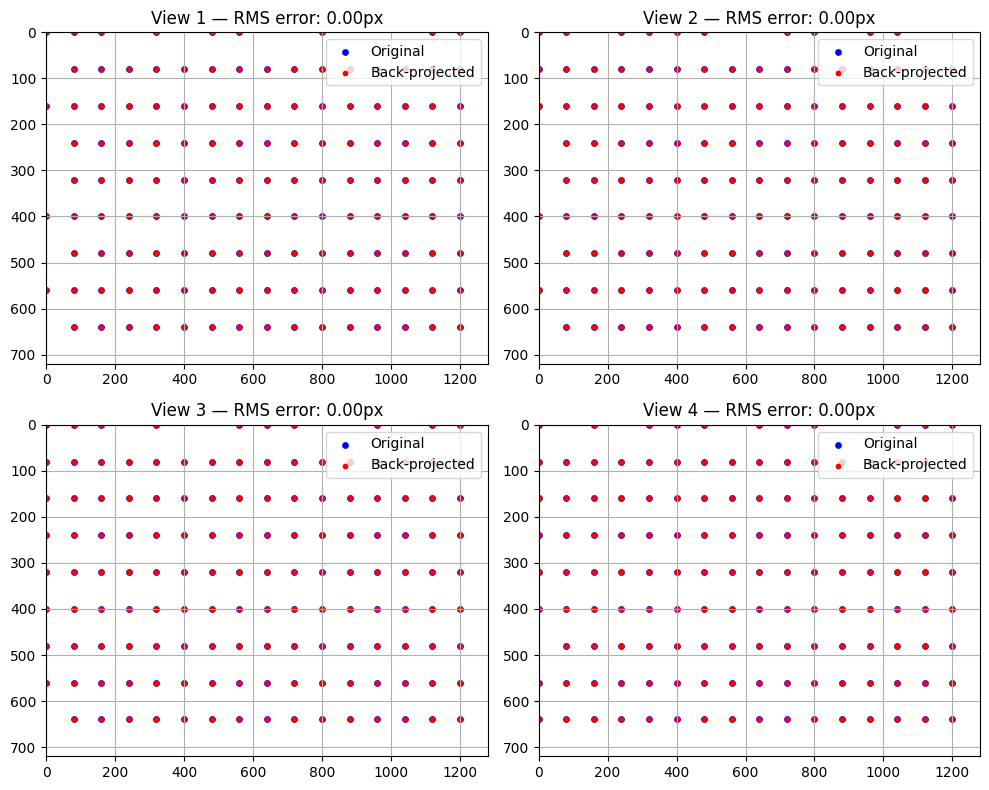

In [3]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# =====================================================
# 1. CAMERA AND FISHEYE PARAMETERS
# =====================================================
fisheye_params = {
    "width": 2592,
    "height": 1944,
    "cx": 1296.0,
    "cy": 972.0,
    "radius": 952.56,
    "theta_max_rad": 1.5708
}

cam_settings = [
    {"fov": 90.0, "pitch": 58.0, "yaw": -18.0},
    {"fov": 90.0, "pitch": 54.0, "yaw": 48.0},
    {"fov": 90.0, "pitch": 28.0, "yaw": 150.0},
    {"fov": 90.0, "pitch": 58.0, "yaw": 294.0},
]

HR, WR = 720, 1280  # rect size

# =====================================================
# 2. GEOMETRY FUNCTIONS
# =====================================================
def compute_basis(yaw_deg, pitch_deg):
    yaw = np.deg2rad(yaw_deg)
    pitch = np.deg2rad(pitch_deg)
    D = np.array([0, 0, 1])
    H = np.array([np.cos(yaw), np.sin(yaw), 0])
    Fv = np.cos(pitch) * D + np.sin(pitch) * H
    Fv /= np.linalg.norm(Fv)
    Rv = np.cross(Fv, D)
    Rv /= np.linalg.norm(Rv)
    Uv = np.cross(Rv, Fv)
    return Fv, Rv, Uv


def rect_to_fisheye_point(u, v, view_params, fisheye_params):
    cx_r, cy_r = WR / 2, HR / 2
    f = (WR / 2) / np.tan(np.deg2rad(view_params["fov"] / 2))
    x = (u - cx_r) / f
    y = (v - cy_r) / f
    z = 1.0
    ray_rect = np.array([x, y, z])
    ray_rect /= np.linalg.norm(ray_rect)

    Fv, Rv, Uv = compute_basis(view_params["yaw"], view_params["pitch"])
    ray_fish = Rv * ray_rect[0] + Uv * ray_rect[1] + Fv * ray_rect[2]

    Xf, Yf, Zf = ray_fish
    theta = np.arccos(np.clip(Zf, -1.0, 1.0))
    phi = np.arctan2(Yf, Xf)
    radius, theta_max = fisheye_params["radius"], fisheye_params["theta_max_rad"]
    cx_f, cy_f = fisheye_params["cx"], fisheye_params["cy"]
    r = (theta / theta_max) * radius
    u_f = cx_f + r * np.cos(phi)
    v_f = cy_f - r * np.sin(phi)
    return u_f, v_f


def fisheye_to_rect_point(u_f, v_f, view_params, fisheye_params):
    cx_f, cy_f = fisheye_params["cx"], fisheye_params["cy"]
    radius, theta_max = fisheye_params["radius"], fisheye_params["theta_max_rad"]

    dx, dy = u_f - cx_f, cy_f - v_f
    r = np.sqrt(dx ** 2 + dy ** 2)
    theta = (r / radius) * theta_max
    phi = np.arctan2(dy, dx)
    sin_t = np.sin(theta)
    ray_fish = np.array([sin_t * np.cos(phi), sin_t * np.sin(phi), np.cos(theta)])

    Fv, Rv, Uv = compute_basis(view_params["yaw"], view_params["pitch"])
    Rmat = np.stack([Rv, Uv, Fv], axis=1)
    ray_rect = Rmat.T @ ray_fish

    Xc, Yc, Zc = ray_rect
    if Zc <= 0:
        return None

    f = (WR / 2) / np.tan(np.deg2rad(view_params["fov"] / 2))
    cx_r, cy_r = WR / 2, HR / 2
    u = f * (Xc / Zc) + cx_r
    v = f * (Yc / Zc) + cy_r
    if 0 <= u < WR and 0 <= v < HR:
        return u, v
    return None

# =====================================================
# 3. ROUND-TRIP TEST
# =====================================================
def test_round_trip(view_params, fisheye_params, view_idx):
    # Grid of test points
    step = 80  # pixel spacing
    us, vs = np.meshgrid(np.arange(0, WR, step), np.arange(0, HR, step))
    pts = np.stack([us, vs], axis=-1).reshape(-1, 2)

    err_list = []
    rect_orig, rect_back = [], []

    for (u, v) in pts:
        # Forward: rect → fisheye
        uf, vf = rect_to_fisheye_point(u, v, view_params, fisheye_params)
        # Reverse: fisheye → rect
        back = fisheye_to_rect_point(uf, vf, view_params, fisheye_params)
        if back is not None:
            ub, vb = back
            err = np.sqrt((u - ub)**2 + (v - vb)**2)
            err_list.append(err)
            rect_orig.append([u, v])
            rect_back.append([ub, vb])

    rect_orig = np.array(rect_orig)
    rect_back = np.array(rect_back)
    rms = np.sqrt(np.mean(np.array(err_list) ** 2)) if err_list else None
    print(f"View {view_idx}: RMS pixel error = {rms:.3f} px ({len(err_list)} points)")
    return rect_orig, rect_back, err_list, rms


# =====================================================
# 4. VISUALIZE ROUND-TRIP ERRORS
# =====================================================
fig, axs = plt.subplots(2, 2, figsize=(10, 8))
axs = axs.ravel()

for i, cam in enumerate(cam_settings):
    rect_orig, rect_back, err, rms = test_round_trip(cam, fisheye_params, i + 1)
    ax = axs[i]
    if len(rect_orig) == 0:
        ax.set_title(f"View {i+1} (no valid pts)")
        continue
    ax.scatter(rect_orig[:, 0], rect_orig[:, 1], c='blue', s=15, label='Original')
    ax.scatter(rect_back[:, 0], rect_back[:, 1], c='red', s=10, label='Back-projected')
    for (xo, yo, xb, yb) in zip(rect_orig[:, 0], rect_orig[:, 1], rect_back[:, 0], rect_back[:, 1]):
        ax.plot([xo, xb], [yo, yb], 'gray', lw=0.5)
    ax.set_xlim([0, WR])
    ax.set_ylim([HR, 0])
    ax.set_title(f"View {i+1} — RMS error: {rms:.2f}px")
    ax.legend()
    ax.grid(True)

plt.tight_layout()
plt.show()


In [1]:

import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
from superpoint import SuperPoint
from superglue import SuperGlue
from scipy.spatial.transform import Rotation as R
from scipy.optimize import least_squares
import time




Using device: cpu
Loaded SuperPoint model
Loaded SuperGlue model ("indoor" weights)


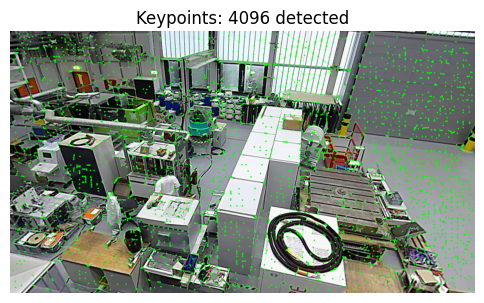

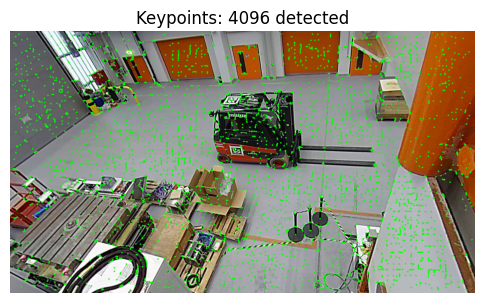

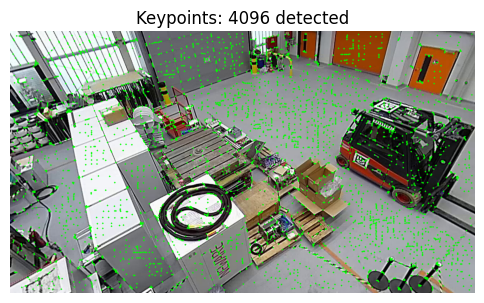

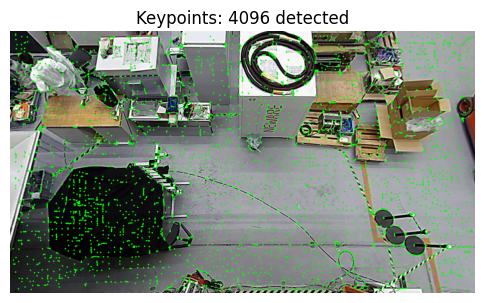

[PAIR] Crop 0 ↔ Crop 1: 598 valid matches (mean conf: 0.292)


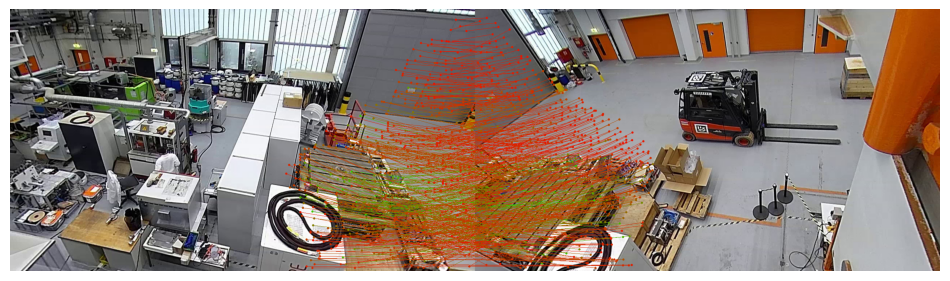

[PAIR] Crop 0 ↔ Crop 2: 1437 valid matches (mean conf: 0.515)


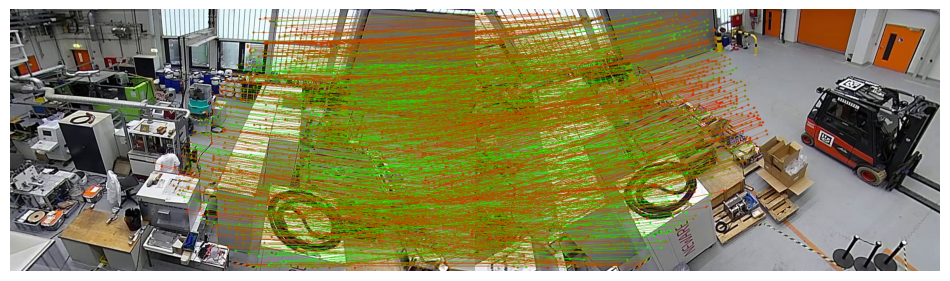

[PAIR] Crop 0 ↔ Crop 3: 950 valid matches (mean conf: 0.613)


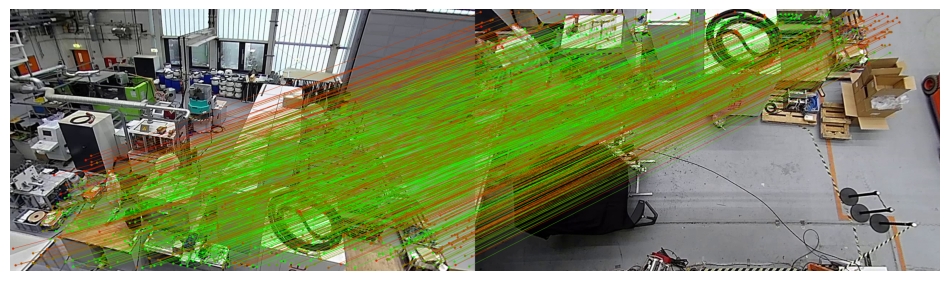

[PAIR] Crop 1 ↔ Crop 2: 1723 valid matches (mean conf: 0.523)


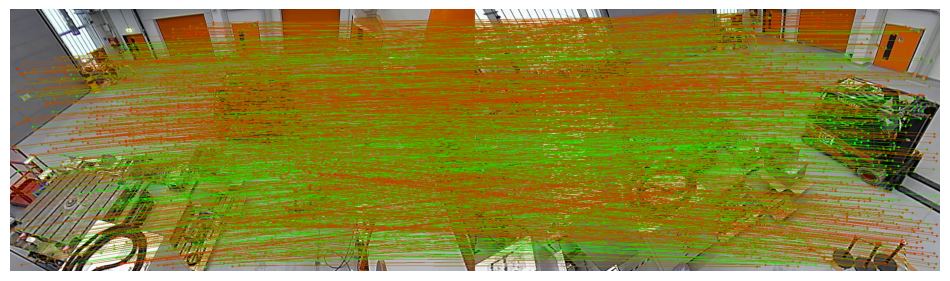

[PAIR] Crop 1 ↔ Crop 3: 308 valid matches (mean conf: 0.155)


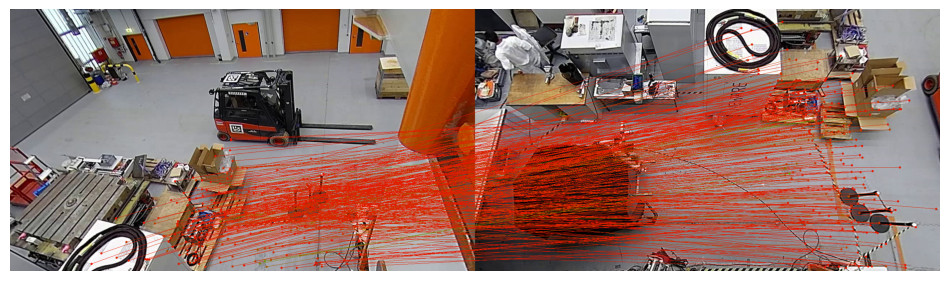

[PAIR] Crop 2 ↔ Crop 3: 1033 valid matches (mean conf: 0.494)


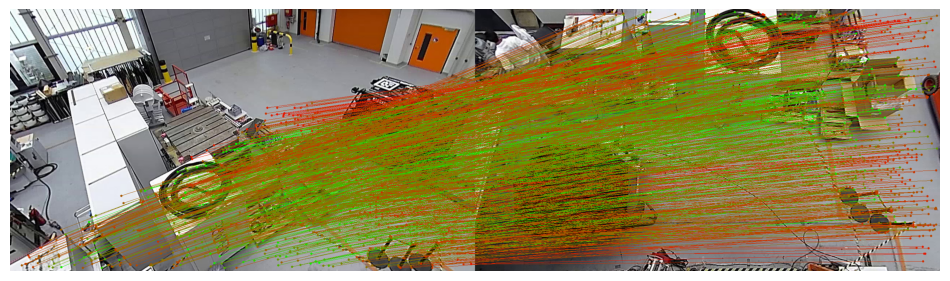

In [2]:

# SUPERPOINT + SUPERGLUE 

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Using device: {device}")

sp_config = {
    'nms_radius': 2,
    'keypoint_threshold': 0.002,
    'max_keypoints': 4096
}
superpoint = SuperPoint(sp_config).to(device).eval()

sg_config = {
    'weights': 'indoor',
    'sinkhorn_iterations': 100,
    'match_threshold': 0.07
}
superglue = SuperGlue(sg_config).to(device).eval()

crop_paths = [
    "ohlf_fisheye/cam_233_view1.jpg",
    "ohlf_fisheye/cam_233_view2.jpg",
    "ohlf_fisheye/cam_233_view3.jpg",
    "ohlf_fisheye/cam_233_view4.jpg"
]

# SuperPoint Detection
keypoints_list, descriptors_list, score_list, images = [], [], [], []

for path in crop_paths:
    img = cv2.imread(path)
    if img is None:
        raise FileNotFoundError(f"Image not found: {path}")

    images.append(img)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).astype(np.float32) / 255.0
    tensor_img = torch.from_numpy(gray).unsqueeze(0).unsqueeze(0)

    with torch.no_grad():
        out = superpoint({'image': tensor_img})

    keypoints = out['keypoints'][0].cpu().numpy()
    descriptors = out['descriptors'][0].cpu().numpy()
    scores = out['scores'][0].cpu().numpy()

    keypoints_list.append(keypoints)
    descriptors_list.append(descriptors)
    score_list.append(scores)

# Visualize Detected Keypoints
    img_disp = img.copy()
    for (x, y) in keypoints.astype(int):
        cv2.circle(img_disp, (x, y), 2, (0, 255, 0), -1)

    plt.figure(figsize=(6, 4))
    plt.imshow(cv2.cvtColor(img_disp, cv2.COLOR_BGR2RGB))
    plt.title(f"Keypoints: {len(keypoints)} detected")
    plt.axis('off')
    plt.show()

# Prepare SuperGlue Input
def prepare_superglue_input(img1, kpts1, desc1, score1, img2, kpts2, desc2, score2):
    gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY).astype(np.float32) / 255.0
    gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY).astype(np.float32) / 255.0
    return {
    'image0': torch.from_numpy(gray1).unsqueeze(0).unsqueeze(0).float().to(device),
    'image1': torch.from_numpy(gray2).unsqueeze(0).unsqueeze(0).float().to(device),

    'keypoints0': torch.from_numpy(kpts1).unsqueeze(0).float().to(device),
    'keypoints1': torch.from_numpy(kpts2).unsqueeze(0).float().to(device),

    'descriptors0': torch.from_numpy(desc1).unsqueeze(0).float().to(device),
    'descriptors1': torch.from_numpy(desc2).unsqueeze(0).float().to(device),

    'scores0': torch.from_numpy(score1).unsqueeze(0).float().to(device),
    'scores1': torch.from_numpy(score2).unsqueeze(0).float().to(device)
}


# Match All Pairs
n_crops = len(images)
matches_dict = {}

for i in range(n_crops):
    for j in range(i + 1, n_crops):
        data = prepare_superglue_input(
            images[i], keypoints_list[i], descriptors_list[i], score_list[i],
            images[j], keypoints_list[j], descriptors_list[j], score_list[j],
        )

        with torch.no_grad():
            pred = superglue(data)

        matches0 = pred['matches0'][0].cpu().numpy()
        conf = pred.get('matching_scores0', [None])[0]
        conf = conf.cpu().numpy() if conf is not None else np.zeros_like(matches0)

        valid = matches0 > -1
        mkpts0 = keypoints_list[i][valid]
        mkpts1 = keypoints_list[j][matches0[valid]]
        mconf = conf[valid]
        matches_dict[(i, j)] = (mkpts0, mkpts1, mconf)

        mean_conf = np.mean(mconf) if len(mconf) > 0 else 0
        print(f"[PAIR] Crop {i} ↔ Crop {j}: {len(mkpts0)} valid matches (mean conf: {mean_conf:.3f})")

        img0 = images[i]
        img1 = images[j]
        h1, w1 = img0.shape[:2]
        h2, w2 = img1.shape[:2]
        canvas = np.zeros((max(h1, h2), w1 + w2, 3), dtype=np.uint8)
        canvas[:h1, :w1] = img0
        canvas[:h2, w1:] = img1

        for (x1, y1), (x2, y2), c in zip(mkpts0.astype(int), mkpts1.astype(int), mconf):
            color = (0, int(255 * c), int(255 * (1 - c)))  
            cv2.circle(canvas, (int(x1), int(y1)), 3, color, -1)
            cv2.circle(canvas, (int(x2) + w1, int(y2)), 3, color, -1)
            cv2.line(canvas, (int(x1), int(y1)), (int(x2) + w1, int(y2)), color, 1)

        plt.figure(figsize=(12, 6))
        plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()


In [3]:


K_fisheye = np.array([
    [1274.7099536921774, 0.0, 640.0],
    [0.0, 1274.7099536921774, 360.0],
    [0.0, 0.0, 1.0],
], dtype=np.float64)


D_fisheye = np.zeros(4, dtype=np.float64)

K_rect = np.array([
    [1280.0, 0.0, 640.0],
    [0.0, 1280.0, 360.0],
    [0.0, 0.0, 1.0],
], dtype=np.float64)


# Helper functions 
def normalize(v):
  
    n = np.linalg.norm(v, axis=-1, keepdims=True)
    n[n == 0] = 1.0
    return v / n

def rectilinear_to_ray(px, K):
  
    px = np.asarray(px, np.float64).reshape(-1, 2)
    fx, fy = K[0,0], K[1,1]
    cx, cy = K[0,2], K[1,2]

    x = (px[:,0] - cx) / fx
    y = (px[:,1] - cy) / fy

    
    v = np.stack([x, y, np.ones_like(x)], axis=-1)  
    return normalize(v)

def fisheye_project_ray(ray, K, D=D_fisheye):
    
    pts = np.asarray(ray, np.float64).reshape(-1, 1, 3)
    imgpts, _ = cv2.fisheye.projectPoints(
        pts,
        np.zeros(3, dtype=np.float64),  
        np.zeros(3, dtype=np.float64),  
        K,
        D,
    )
    return imgpts.reshape(-1, 2)


def choose_ref(matches):
    counts = {}
    for (i, j), v in matches.items():
        counts[i] = counts.get(i, 0) + len(v[0])
        counts[j] = counts.get(j, 0) + len(v[1])

    return max(counts, key=counts.get) if counts else 0


def ransac_filter_rotation(mk0, mk1, K_rect, max_iter=500, sample_size=5, ang_thresh_deg=1.0):
   
    mk0 = np.asarray(mk0, dtype=np.float64)
    mk1 = np.asarray(mk1, dtype=np.float64)
    n = len(mk0)
    if n < 3:
        return np.zeros(n, dtype=bool)

    r0_all = rectilinear_to_ray(mk0, K_rect)
    r1_all = rectilinear_to_ray(mk1, K_rect)

    best_inliers = []
    ang_thresh = np.deg2rad(ang_thresh_deg)
    idxs = np.arange(n)

    for _ in range(max_iter):
        samp = np.random.choice(idxs, min(sample_size, n), replace=False)
        try:
            H = r0_all[samp].T @ r1_all[samp]
            U, _, Vt = np.linalg.svd(H)
            Rm = Vt.T @ U.T
            if np.linalg.det(Rm) < 0:
                Vt[-1, :] *= -1
                Rm = Vt.T @ U.T
        except Exception:
            continue

        r0_rot = (Rm @ r0_all.T).T
        cosang = np.clip(np.sum(r0_rot * r1_all, axis=1), -1.0, 1.0)
        ang = np.arccos(cosang)

        inliers = np.where(ang < ang_thresh)[0]
        if len(inliers) > len(best_inliers):
            best_inliers = inliers

        if len(best_inliers) > 0.95 * n:
            break

    mask = np.zeros(n, dtype=bool)
    if len(best_inliers) > 0:
        mask[best_inliers] = True

    return mask


# Build matches and choose reference 
REF_IDX = choose_ref(matches_dict)
print(f"[info] Reference crop index: {REF_IDX}")

pairs = []
for (i, j), v in matches_dict.items():
    mk0 = np.asarray(v[0], dtype=np.float64)
    mk1 = np.asarray(v[1], dtype=np.float64)
    if len(mk0) < 6:
        continue

    mask = ransac_filter_rotation(mk0, mk1, K_rect)
    mk0_in = mk0[mask]
    mk1_in = mk1[mask]
    if len(mk0_in) < 6:
        continue

    pairs.append((i, j, mk0_in, mk1_in))

print(f"[RANSAC] Retained {len(pairs)} pairs")


# Prepare BA variables
n_crops = len(images)
camera_indices = [i for i in range(n_crops) if i != REF_IDX]


def pack_rotvecs(rot):
    return np.hstack([rot[i] for i in camera_indices]) if camera_indices else np.array([])


def unpack_rotvecs(x):
    r = {i: np.zeros(3, dtype=np.float64) for i in range(n_crops)}
    if x.size == 0:
        return r
    idx = 0
    for i in camera_indices:
        r[i] = x[idx:idx + 3].copy()
        idx += 3
    return r


rotvecs_init = {i: np.zeros(3, dtype=np.float64) for i in range(n_crops)}
x0 = pack_rotvecs(rotvecs_init)


# Ray-BA
def residuals_ray_BA(x):
    rotvecs = unpack_rotvecs(x)
    parts = []

    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        Ra = (R0 @ r0.T).T
        Rb = (R1 @ r1.T).T

        n = float(max(1.0, r0.shape[0]))
        parts.append((np.cross(Ra, Rb) / np.sqrt(n)).ravel())

    return np.hstack(parts) if parts else np.array([])


print("Running Ray-BA ...")
t0 = time.time()
res = least_squares(
    residuals_ray_BA,
    x0,
    loss="soft_l1",
    f_scale=0.8,
    ftol=1e-12,
    xtol=1e-12,
    max_nfev=400,
    verbose=2,
)
x_opt = res.x
rotvecs_opt = unpack_rotvecs(x_opt)
print(f"Ray-BA done, cost={res.cost:.6g}, time={(time.time() - t0):.1f}s")


# Pixel-BA
def pixel_residuals(x):
    rotvecs = unpack_rotvecs(x)
    Kf = K_fisheye.copy()

    parts = []
    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        rw0 = (R0 @ r0.T).T
        rw1 = (R1 @ r1.T).T

        p0 = fisheye_project_ray(rw0, Kf)
        p1 = fisheye_project_ray(rw1, Kf)

        n = float(max(1.0, r0.shape[0]))
        parts.append(((p0 - p1) / np.sqrt(n)).ravel())

    return np.hstack(parts) if parts else np.array([])


print("pixel-space refinement...")
res_pix = least_squares(
    lambda x: pixel_residuals(x),
    x_opt,
    loss="soft_l1",
    f_scale=0.8,
    ftol=1e-12,
    xtol=1e-12,
    max_nfev=300,
    verbose=2,
)

x_pix = res_pix.x
rotvecs_opt = unpack_rotvecs(x_pix)


# Diagnostics
def compute_angular_error(rotvecs_dict):
    angs = []
    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs_dict[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs_dict[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        rw0 = (R0 @ r0.T).T
        rw1 = (R1 @ r1.T).T

        cosang = np.clip(np.sum(rw0 * rw1, axis=1), -1.0, 1.0)
        angs.extend(np.degrees(np.arccos(cosang)))

    return np.array(angs)


res_final = pixel_residuals(x_pix)
errs = np.linalg.norm(res_final.reshape(-1, 2), axis=1) if res_final.size else np.array([])
ang_errs_pix = compute_angular_error(rotvecs_opt)

sp_sg_mean_px = np.nanmean(errs)
sp_sg_median_px = np.nanmedian(errs)
sp_sg_mean_ang = np.nanmean(ang_errs_pix)
sp_sg_median_ang = np.nanmedian(ang_errs_pix)

for i in range(n_crops):
    if i == REF_IDX:
        R_opt = np.eye(3)
        print(f"\nCamera {i} (Reference):\n{R_opt}")
    else:
        R_opt = R.from_rotvec(rotvecs_opt[i]).as_matrix()
        print(f"\nCamera {i}:\n{R_opt}")
print(
    f"Pixel Error: mean={np.nanmean(errs):.3f}px, median={np.nanmedian(errs):.3f}px"
)
print(
    f"Angular Error: mean={np.nanmean(ang_errs_pix):.3f}°, median={np.nanmedian(ang_errs_pix):.3f}°"
)


[info] Reference crop index: 2
[RANSAC] Retained 6 pairs
Running Ray-BA ...
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         3.9413e-01                                    9.00e-01    
       1              2         1.8473e-02      3.76e-01       1.00e+00       1.99e-01    
       2              3         8.9140e-04      1.76e-02       2.48e-01       1.91e-02    
       3              4         7.4252e-04      1.49e-04       1.09e-02       4.86e-05    
       4              5         7.4252e-04      7.75e-10       8.93e-05       1.41e-07    
       5              6         7.4252e-04      1.60e-13       2.42e-06       3.31e-09    
`gtol` termination condition is satisfied.
Function evaluations 6, initial cost 3.9413e-01, final cost 7.4252e-04, first-order optimality 3.31e-09.
Ray-BA done, cost=0.000742516, time=0.2s
pixel-space refinement...
   Iteration     Total nfev        Cost      Cost reduction    Step norm

[INFO] Using device: cpu


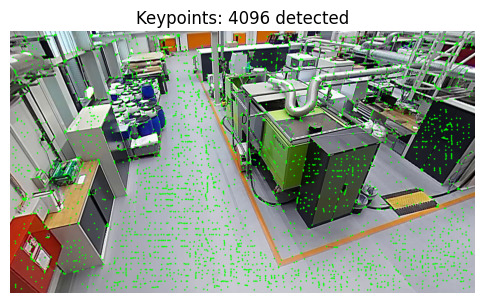

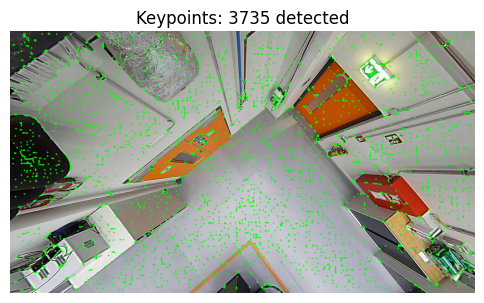

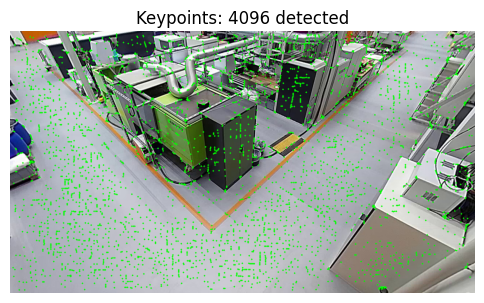

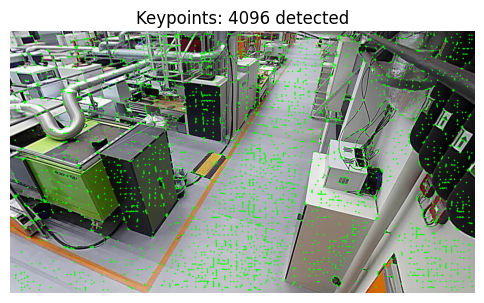

[PAIR] Crop 0 ↔ Crop 1: 11 valid matches (mean conf: 0.117)


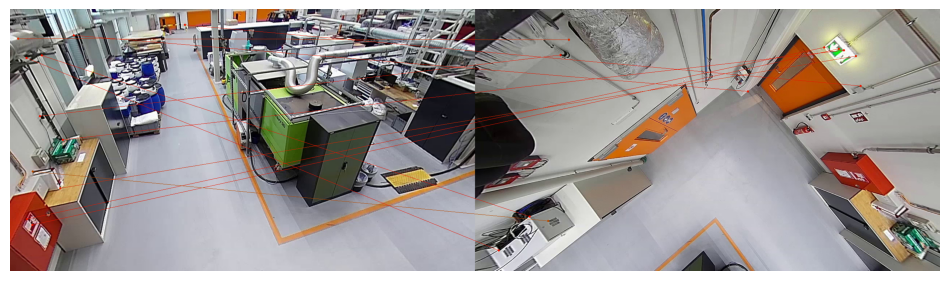

[PAIR] Crop 0 ↔ Crop 2: 1344 valid matches (mean conf: 0.736)


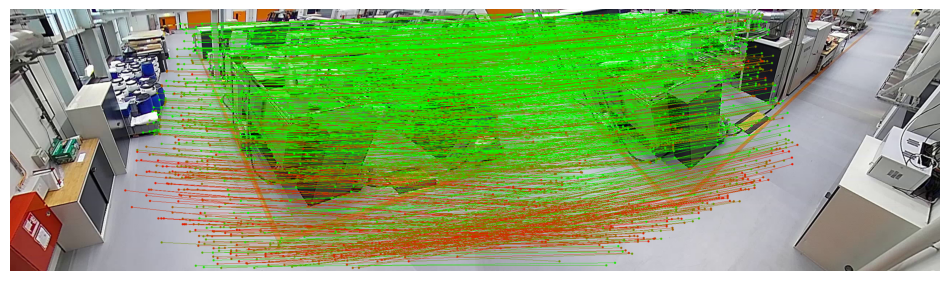

[PAIR] Crop 0 ↔ Crop 3: 1025 valid matches (mean conf: 0.705)


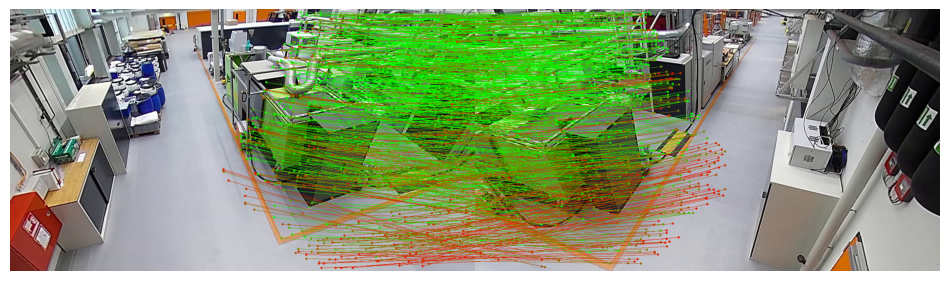

[PAIR] Crop 1 ↔ Crop 2: 8 valid matches (mean conf: 0.117)


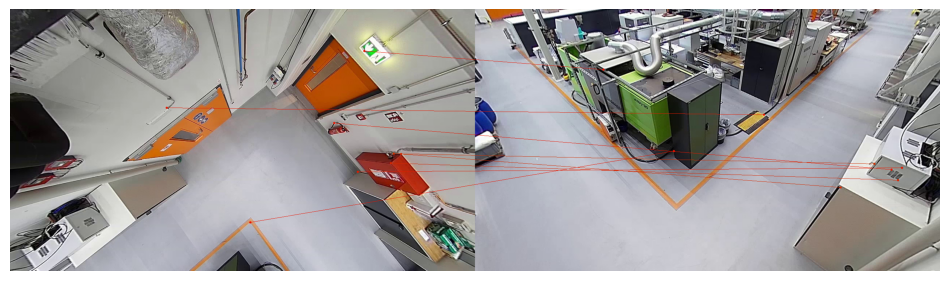

[PAIR] Crop 1 ↔ Crop 3: 8 valid matches (mean conf: 0.176)


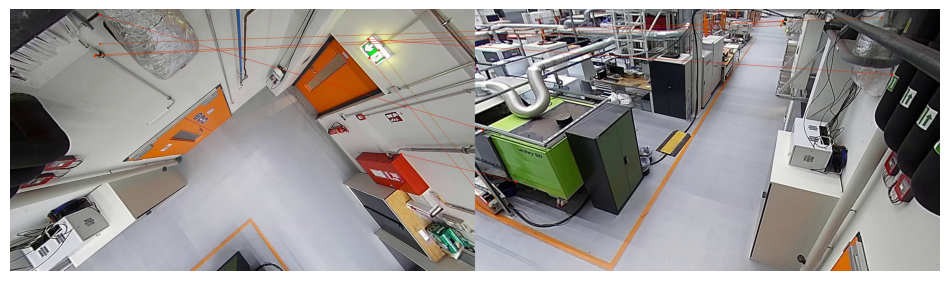

[PAIR] Crop 2 ↔ Crop 3: 1509 valid matches (mean conf: 0.718)


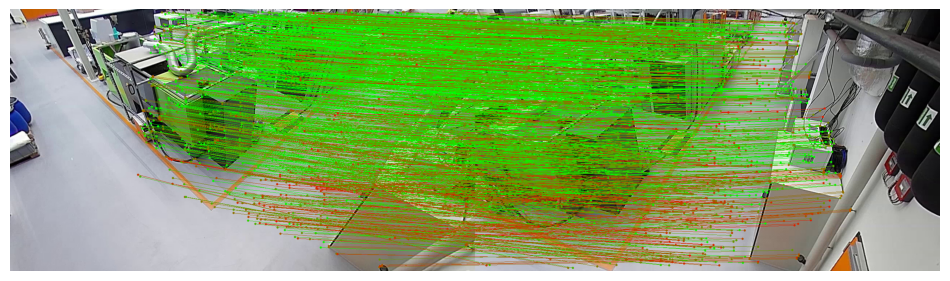

In [12]:

# SUPERPOINT + LIGHTGLUE 
from lightglue import LightGlue, SuperPoint

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"[INFO] Using device: {device}")

superpoint = SuperPoint(
    max_num_keypoints=4096,
    nms_radius=2,
    detection_threshold=0.002
).eval().to(device)

matcher = LightGlue(
    features='superpoint',
    filter_threshold=0.07,
    width_confidence=0.99,
    depth_confidence=0.95
).eval().to(device)

crop_paths = [
    "ohlf_fisheye/cam_232_view1.jpg",
    "ohlf_fisheye/cam_232_view2.jpg",
    "ohlf_fisheye/cam_232_view3.jpg",
    "ohlf_fisheye/cam_232_view4.jpg"
]

images, image_bgr = [], []
for path in crop_paths:
    img_bgr = cv2.imread(path)
    if img_bgr is None:
        raise FileNotFoundError(f"Image not found: {path}")
    gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY).astype(np.float32) / 255.0
    img_tensor  = torch.from_numpy(gray).unsqueeze(0).unsqueeze(0) 
    images.append(img_tensor)
    image_bgr.append(img_bgr)

# Extract SuperPoint features 
features = []
for idx, (img, img_bgr) in enumerate(zip(images,image_bgr)):
    with torch.no_grad():
        feat = superpoint({'image': img})
        for key in ['keypoints', 'descriptors']:
            if feat[key].ndim == 2:
                feat[key] = feat[key].unsqueeze(0)
        features.append(feat)

    n_kpts = feat['keypoints'].shape[1]
    keypoints = feat['keypoints'][0].cpu().numpy()
    img_disp = img_bgr.copy()
    for (x, y) in keypoints.astype(int):
        cv2.circle(img_disp, (x, y), 2, (0, 255, 0), -1)

    plt.figure(figsize=(6, 4))
    plt.imshow(cv2.cvtColor(img_disp, cv2.COLOR_BGR2RGB))
    plt.title(f"Keypoints: {len(keypoints)} detected")
    plt.axis('off')
    plt.show()

# Match all pairs
n_crops = len(images)
matches_dict = {}

for i in range(n_crops):
    for j in range(i + 1, n_crops):
        data = {'image0': features[i], 'image1': features[j]}
        with torch.no_grad():
            pred = matcher(data)

        matches0 = pred['matches0'][0].cpu().numpy()
        conf = pred.get('matching_scores0', [None])[0]
        conf = conf.cpu().numpy() if conf is not None else np.zeros_like(matches0)

        valid = matches0 > -1
        mkpts0 = features[i]['keypoints'][0].cpu().numpy()[valid]
        mkpts1 = features[j]['keypoints'][0].cpu().numpy()[matches0[valid]]
        mconf = conf[valid]
        matches_dict[(i, j)] = (mkpts0, mkpts1, mconf)

        mean_conf = np.mean(mconf) if len(mconf) > 0 else 0
        print(f"[PAIR] Crop {i} ↔ Crop {j}: {len(mkpts0)} valid matches (mean conf: {mean_conf:.3f})")

        img0 = image_bgr[i]
        img1 = image_bgr[j]
        h1, w1 = img0.shape[:2]
        h2, w2 = img1.shape[:2]
        canvas = np.zeros((max(h1, h2), w1 + w2, 3), dtype=np.uint8)
        canvas[:h1, :w1] = img0
        canvas[:h2, w1:] = img1

        for (x1, y1), (x2, y2), c in zip(mkpts0.astype(int), mkpts1.astype(int), mconf):
            color = (0, int(255 * c), int(255 * (1 - c)))  
            cv2.circle(canvas, (int(x1), int(y1)), 3, color, -1)
            cv2.circle(canvas, (int(x2) + w1, int(y2)), 3, color, -1)
            cv2.line(canvas, (int(x1), int(y1)), (int(x2) + w1, int(y2)), color, 1)

        plt.figure(figsize=(12, 6))
        plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()



In [5]:


K_fisheye = np.array([
    [1274.7099536921774, 0.0, 640.0],
    [0.0, 1274.7099536921774, 360.0],
    [0.0, 0.0, 1.0],
], dtype=np.float64)


D_fisheye = np.zeros(4, dtype=np.float64)

K_rect = np.array([
    [1280.0, 0.0, 640.0],
    [0.0, 1280.0, 360.0],
    [0.0, 0.0, 1.0],
], dtype=np.float64)


# Helper functions


def normalize(v):
  
    n = np.linalg.norm(v, axis=-1, keepdims=True)
    n[n == 0] = 1.0
    return v / n

def rectilinear_to_ray(px, K):
  
    px = np.asarray(px, np.float64).reshape(-1, 2)
    fx, fy = K[0,0], K[1,1]
    cx, cy = K[0,2], K[1,2]

    x = (px[:,0] - cx) / fx
    y = (px[:,1] - cy) / fy

    v = np.stack([x, y, np.ones_like(x)], axis=-1) 
    return normalize(v)

def fisheye_project_ray(ray, K, D=D_fisheye):
    
    pts = np.asarray(ray, np.float64).reshape(-1, 1, 3)
    imgpts, _ = cv2.fisheye.projectPoints(
        pts,
        np.zeros(3, dtype=np.float64),  
        np.zeros(3, dtype=np.float64),  
        K,
        D,
    )
    return imgpts.reshape(-1, 2)


def choose_ref(matches):
    counts = {}
    for (i, j), v in matches.items():
        counts[i] = counts.get(i, 0) + len(v[0])
        counts[j] = counts.get(j, 0) + len(v[1])

    return max(counts, key=counts.get) if counts else 0


def ransac_filter_rotation(mk0, mk1, K_rect, max_iter=500, sample_size=5, ang_thresh_deg=1.0):
   
    mk0 = np.asarray(mk0, dtype=np.float64)
    mk1 = np.asarray(mk1, dtype=np.float64)
    n = len(mk0)
    if n < 3:
        return np.zeros(n, dtype=bool)

    r0_all = rectilinear_to_ray(mk0, K_rect)
    r1_all = rectilinear_to_ray(mk1, K_rect)

    best_inliers = []
    ang_thresh = np.deg2rad(ang_thresh_deg)
    idxs = np.arange(n)

    for _ in range(max_iter):
        samp = np.random.choice(idxs, min(sample_size, n), replace=False)
        try:
            H = r0_all[samp].T @ r1_all[samp]
            U, _, Vt = np.linalg.svd(H)
            Rm = Vt.T @ U.T
            if np.linalg.det(Rm) < 0:
                Vt[-1, :] *= -1
                Rm = Vt.T @ U.T
        except Exception:
            continue

        r0_rot = (Rm @ r0_all.T).T
        cosang = np.clip(np.sum(r0_rot * r1_all, axis=1), -1.0, 1.0)
        ang = np.arccos(cosang)

        inliers = np.where(ang < ang_thresh)[0]
        if len(inliers) > len(best_inliers):
            best_inliers = inliers

        if len(best_inliers) > 0.95 * n:
            break

    mask = np.zeros(n, dtype=bool)
    if len(best_inliers) > 0:
        mask[best_inliers] = True

    return mask


# Build matches and choose reference
REF_IDX = choose_ref(matches_dict)
print(f"[info] Reference crop index: {REF_IDX}")

pairs = []
for (i, j), v in matches_dict.items():
    mk0 = np.asarray(v[0], dtype=np.float64)
    mk1 = np.asarray(v[1], dtype=np.float64)
    if len(mk0) < 6:
        continue

    mask = ransac_filter_rotation(mk0, mk1, K_rect)
    mk0_in = mk0[mask]
    mk1_in = mk1[mask]
    if len(mk0_in) < 6:
        continue

    pairs.append((i, j, mk0_in, mk1_in))

print(f"[RANSAC] Retained {len(pairs)} pairs")


# Prepare BA variables
n_crops = len(images)
camera_indices = [i for i in range(n_crops) if i != REF_IDX]


def pack_rotvecs(rot):
    return np.hstack([rot[i] for i in camera_indices]) if camera_indices else np.array([])


def unpack_rotvecs(x):
    r = {i: np.zeros(3, dtype=np.float64) for i in range(n_crops)}
    if x.size == 0:
        return r
    idx = 0
    for i in camera_indices:
        r[i] = x[idx:idx + 3].copy()
        idx += 3
    return r


rotvecs_init = {i: np.zeros(3, dtype=np.float64) for i in range(n_crops)}
x0 = pack_rotvecs(rotvecs_init)


# Ray-BA
def residuals_ray_BA(x):
    rotvecs = unpack_rotvecs(x)
    parts = []

    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        Ra = (R0 @ r0.T).T
        Rb = (R1 @ r1.T).T

        n = float(max(1.0, r0.shape[0]))
        parts.append((np.cross(Ra, Rb) / np.sqrt(n)).ravel())

    return np.hstack(parts) if parts else np.array([])


print("Running Ray-BA ...")
t0 = time.time()
res = least_squares(
    residuals_ray_BA,
    x0,
    loss="soft_l1",
    f_scale=0.8,
    ftol=1e-12,
    xtol=1e-12,
    max_nfev=400,
    verbose=2,
)
x_opt = res.x
rotvecs_opt = unpack_rotvecs(x_opt)
print(f"Ray-BA done, cost={res.cost:.6g}, time={(time.time() - t0):.1f}s")


# Pixel-BA
def pixel_residuals(x):
    rotvecs = unpack_rotvecs(x)
    Kf = K_fisheye.copy()

    parts = []
    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        rw0 = (R0 @ r0.T).T
        rw1 = (R1 @ r1.T).T

        p0 = fisheye_project_ray(rw0, Kf)
        p1 = fisheye_project_ray(rw1, Kf)

        n = float(max(1.0, r0.shape[0]))
        parts.append(((p0 - p1) / np.sqrt(n)).ravel())

    return np.hstack(parts) if parts else np.array([])


print(" pixel-space refinement...")
res_pix = least_squares(
    lambda x: pixel_residuals(x),
    x_opt,
    loss="soft_l1",
    f_scale=0.8,
    ftol=1e-12,
    xtol=1e-12,
    max_nfev=300,
    verbose=2,
)

x_pix = res_pix.x
rotvecs_opt = unpack_rotvecs(x_pix)


# Diagnostics
def compute_angular_error(rotvecs_dict):
    angs = []
    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs_dict[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs_dict[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        rw0 = (R0 @ r0.T).T
        rw1 = (R1 @ r1.T).T

        cosang = np.clip(np.sum(rw0 * rw1, axis=1), -1.0, 1.0)
        angs.extend(np.degrees(np.arccos(cosang)))

    return np.array(angs)


res_final = pixel_residuals(x_pix)
errs = np.linalg.norm(res_final.reshape(-1, 2), axis=1) if res_final.size else np.array([])
ang_errs_pix = compute_angular_error(rotvecs_opt)

sp_lg_mean_px = np.nanmean(errs)
sp_lg_median_px = np.nanmedian(errs)
sp_lg_mean_ang = np.nanmean(ang_errs_pix)
sp_lg_median_ang = np.nanmedian(ang_errs_pix)

for i in range(n_crops):
    if i == REF_IDX:
        R_opt = np.eye(3)
        print(f"\nCamera {i} (Reference):\n{R_opt}")
    else:
        R_opt = R.from_rotvec(rotvecs_opt[i]).as_matrix()
        print(f"\nCamera {i}:\n{R_opt}")
print(
    f"Pixel Error: mean={np.nanmean(errs):.3f}px, median={np.nanmedian(errs):.3f}px"
)
print(
    f"Angular Error: mean={np.nanmean(ang_errs_pix):.3f}°, median={np.nanmedian(ang_errs_pix):.3f}°"
)


[info] Reference crop index: 2
[RANSAC] Retained 4 pairs
Running Ray-BA ...
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         1.8581e-01                                    5.18e-01    
       1              2         1.0085e-02      1.76e-01       1.00e+00       1.26e-01    
       2              3         3.7035e-04      9.72e-03       1.82e-01       6.30e-03    
       3              4         3.5013e-04      2.02e-05       5.57e-03       6.93e-06    
       4              5         3.5013e-04      1.92e-11       5.70e-06       4.05e-09    
`gtol` termination condition is satisfied.
Function evaluations 5, initial cost 1.8581e-01, final cost 3.5013e-04, first-order optimality 4.05e-09.
Ray-BA done, cost=0.000350127, time=0.1s
 pixel-space refinement...
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         4.9509e+02                             

[INFO] Using device: cpu


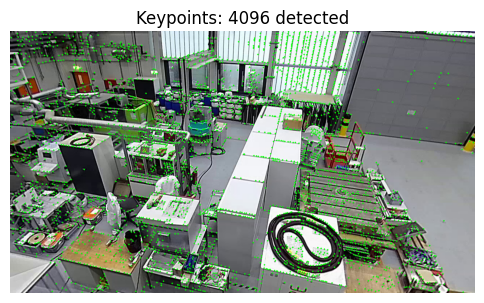

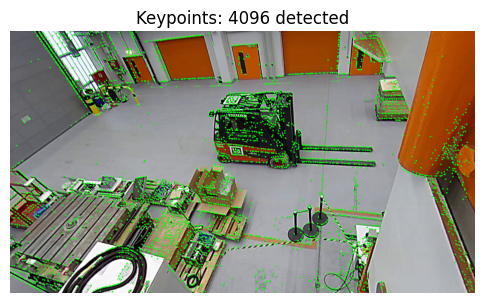

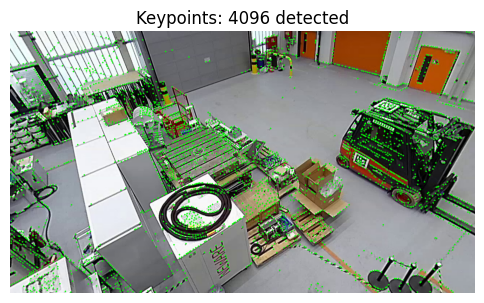

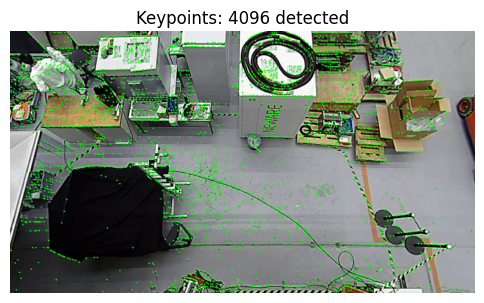

[PAIR] Crop 0 ↔ Crop 1: 78 matches (mean conf: 0.219)


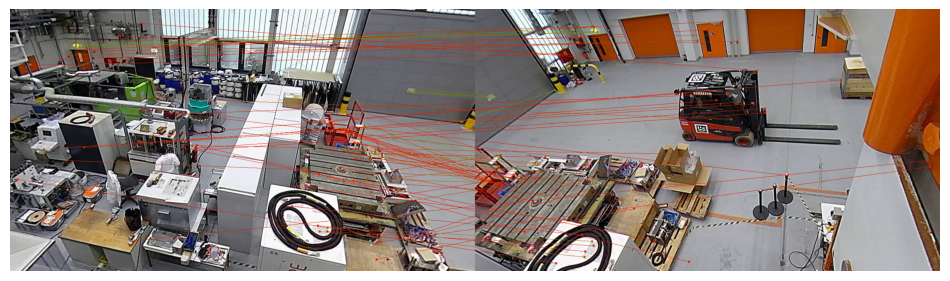

[PAIR] Crop 0 ↔ Crop 2: 1325 matches (mean conf: 0.814)


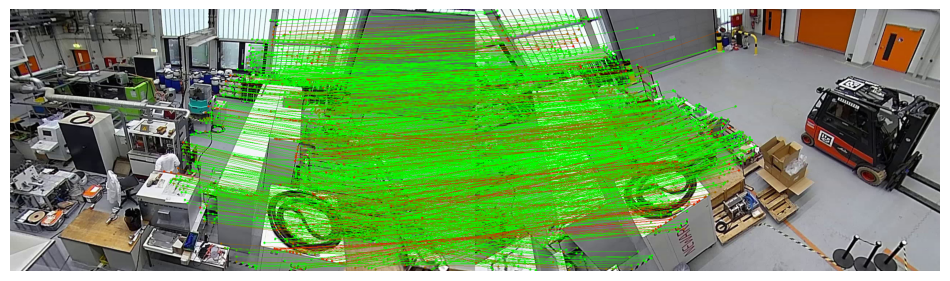

[PAIR] Crop 0 ↔ Crop 3: 1130 matches (mean conf: 0.822)


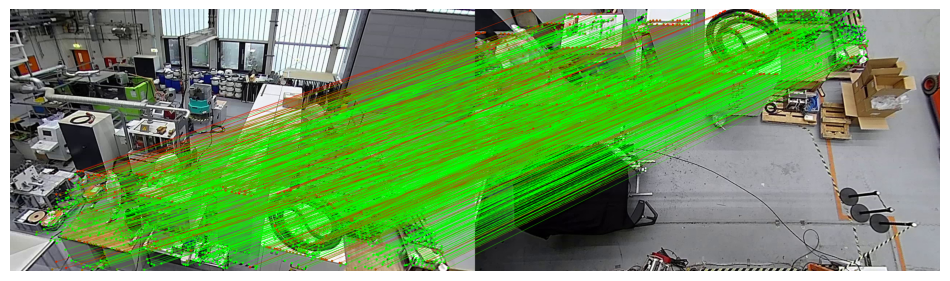

[PAIR] Crop 1 ↔ Crop 2: 1631 matches (mean conf: 0.820)


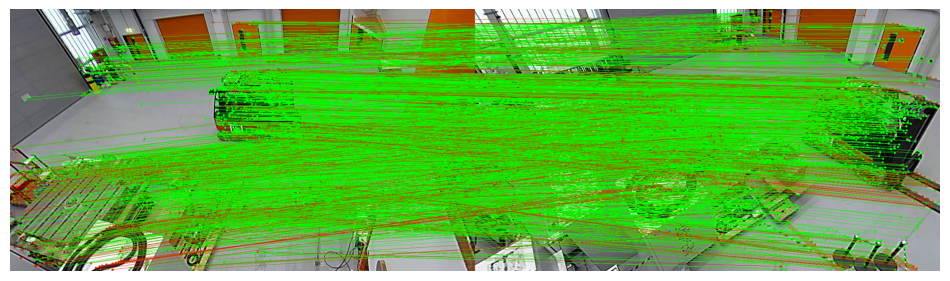

[PAIR] Crop 1 ↔ Crop 3: 39 matches (mean conf: 0.156)


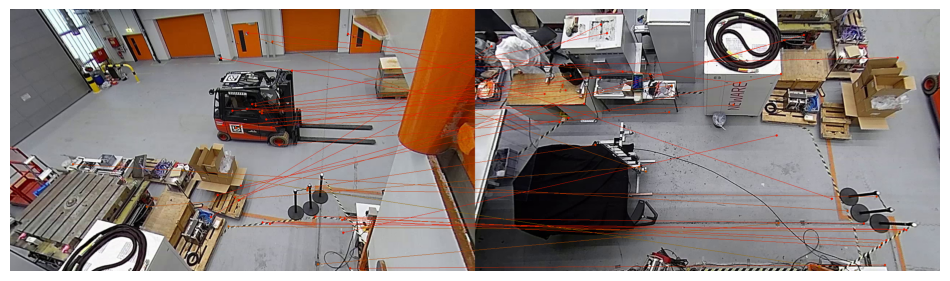

[PAIR] Crop 2 ↔ Crop 3: 869 matches (mean conf: 0.800)


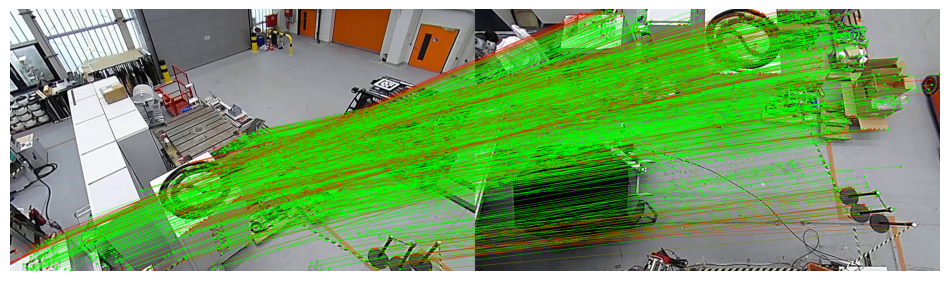

In [6]:

# ALIKED + LIGHTGLUE 

from lightglue import LightGlue, ALIKED

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"[INFO] Using device: {device}")

aliked = ALIKED(
    max_num_keypoints=4096,
    detection_threshold=0.002
).eval().to(device)

matcher = LightGlue(
    features='aliked',
    filter_threshold=0.07,
    width_confidence=0.99,
    depth_confidence=0.95
).eval().to(device)

crop_paths = [
    "ohlf_fisheye/cam_233_view1.jpg",
    "ohlf_fisheye/cam_233_view2.jpg",
    "ohlf_fisheye/cam_233_view3.jpg",
    "ohlf_fisheye/cam_233_view4.jpg"
]

images,image_bgr = [], []
for path in crop_paths:
    img_bgr = cv2.imread(path)
    if img_bgr is None:
        raise FileNotFoundError(f"Image not found: {path}")
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_tensor = torch.from_numpy(img_rgb).permute(2, 0, 1).float() / 255.0
    img_tensor = img_tensor.unsqueeze(0).to(device)
    images.append(img_tensor)
    image_bgr.append(img_bgr)

# Extract ALIKED features 
features = []
for idx, (img, img_bgr) in enumerate(zip(images,image_bgr)):
    with torch.no_grad():
        feat = aliked({'image': img})
        for key in ['keypoints', 'descriptors']:
            if feat[key].ndim == 2:
                feat[key] = feat[key].unsqueeze(0)
        features.append(feat)

    n_kpts = feat['keypoints'].shape[1]
    keypoints = feat['keypoints'][0].cpu().numpy()
    img_disp = img_bgr.copy()
    for (x, y) in keypoints.astype(int):
        cv2.circle(img_disp, (x, y), 2, (0, 255, 0), -1)

    plt.figure(figsize=(6, 4))
    plt.imshow(cv2.cvtColor(img_disp, cv2.COLOR_BGR2RGB))
    plt.title(f"Keypoints: {len(keypoints)} detected")
    plt.axis('off')
    plt.show()

# Match all pairs
n_crops = len(images)
matches_dict = {}

for i in range(n_crops):
    for j in range(i + 1, n_crops):
        data = {'image0': features[i], 'image1': features[j]}
        with torch.no_grad():
            pred = matcher(data)

        matches0 = pred['matches0'][0].cpu().numpy()
        conf = pred.get('matching_scores0', None)
        conf = conf[0].cpu().numpy() if conf is not None else np.zeros_like(matches0)
        valid = matches0 > -1

        mkpts0 = features[i]['keypoints'][0].cpu().numpy()[valid]
        mkpts1 = features[j]['keypoints'][0].cpu().numpy()[matches0[valid]]
        mconf = conf[valid]
        matches_dict[(i, j)] = (mkpts0, mkpts1, mconf)

        mean_conf = np.mean(mconf) if len(mconf) > 0 else 0
        print(f"[PAIR] Crop {i} ↔ Crop {j}: {len(mkpts0)} matches (mean conf: {mean_conf:.3f})")

        img0 = image_bgr[i]
        img1 = image_bgr[j]
        h1, w1 = img0.shape[:2]
        h2, w2 = img1.shape[:2]
        canvas = np.zeros((max(h1, h2), w1 + w2, 3), dtype=np.uint8)
        canvas[:h1, :w1] = img0
        canvas[:h2, w1:] = img1

        for (x1, y1), (x2, y2), c in zip(mkpts0.astype(int), mkpts1.astype(int), mconf):
            color = (0, int(255 * c), int(255 * (1 - c)))  
            cv2.circle(canvas, (int(x1), int(y1)), 3, color, -1)
            cv2.circle(canvas, (int(x2) + w1, int(y2)), 3, color, -1)
            cv2.line(canvas, (int(x1), int(y1)), (int(x2) + w1, int(y2)), color, 1)

        plt.figure(figsize=(12, 6))
        plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()
        


In [7]:


K_fisheye = np.array([
    [1274.7099536921774, 0.0, 640.0],
    [0.0, 1274.7099536921774, 360.0],
    [0.0, 0.0, 1.0],
], dtype=np.float64)


D_fisheye = np.zeros(4, dtype=np.float64)

K_rect = np.array([
    [1280.0, 0.0, 640.0],
    [0.0, 1280.0, 360.0],
    [0.0, 0.0, 1.0],
], dtype=np.float64)


def normalize(v):
  
    n = np.linalg.norm(v, axis=-1, keepdims=True)
    n[n == 0] = 1.0
    return v / n

def rectilinear_to_ray(px, K):
  
    px = np.asarray(px, np.float64).reshape(-1, 2)
    fx, fy = K[0,0], K[1,1]
    cx, cy = K[0,2], K[1,2]

    x = (px[:,0] - cx) / fx
    y = (px[:,1] - cy) / fy
    v = np.stack([x, y, np.ones_like(x)], axis=-1)  
    return normalize(v)

def fisheye_project_ray(ray, K, D=D_fisheye):
    
    pts = np.asarray(ray, np.float64).reshape(-1, 1, 3)
    imgpts, _ = cv2.fisheye.projectPoints(
        pts,
        np.zeros(3, dtype=np.float64),  
        np.zeros(3, dtype=np.float64),  
        K,
        D,
    )
    return imgpts.reshape(-1, 2)


def choose_ref(matches):
    counts = {}
    for (i, j), v in matches.items():
        counts[i] = counts.get(i, 0) + len(v[0])
        counts[j] = counts.get(j, 0) + len(v[1])

    return max(counts, key=counts.get) if counts else 0


def ransac_filter_rotation(mk0, mk1, K_rect, max_iter=500, sample_size=5, ang_thresh_deg=1.0):
   
    mk0 = np.asarray(mk0, dtype=np.float64)
    mk1 = np.asarray(mk1, dtype=np.float64)
    n = len(mk0)
    if n < 3:
        return np.zeros(n, dtype=bool)

    r0_all = rectilinear_to_ray(mk0, K_rect)
    r1_all = rectilinear_to_ray(mk1, K_rect)

    best_inliers = []
    ang_thresh = np.deg2rad(ang_thresh_deg)
    idxs = np.arange(n)

    for _ in range(max_iter):
        samp = np.random.choice(idxs, min(sample_size, n), replace=False)
        try:
            H = r0_all[samp].T @ r1_all[samp]
            U, _, Vt = np.linalg.svd(H)
            Rm = Vt.T @ U.T
            if np.linalg.det(Rm) < 0:
                Vt[-1, :] *= -1
                Rm = Vt.T @ U.T
        except Exception:
            continue

        r0_rot = (Rm @ r0_all.T).T
        cosang = np.clip(np.sum(r0_rot * r1_all, axis=1), -1.0, 1.0)
        ang = np.arccos(cosang)

        inliers = np.where(ang < ang_thresh)[0]
        if len(inliers) > len(best_inliers):
            best_inliers = inliers

        if len(best_inliers) > 0.95 * n:
            break

    mask = np.zeros(n, dtype=bool)
    if len(best_inliers) > 0:
        mask[best_inliers] = True

    return mask


# Build matches and choose reference 
REF_IDX = choose_ref(matches_dict)
print(f"[info] Reference crop index: {REF_IDX}")

pairs = []
for (i, j), v in matches_dict.items():
    mk0 = np.asarray(v[0], dtype=np.float64)
    mk1 = np.asarray(v[1], dtype=np.float64)
    if len(mk0) < 6:
        continue

    mask = ransac_filter_rotation(mk0, mk1, K_rect)
    mk0_in = mk0[mask]
    mk1_in = mk1[mask]
    if len(mk0_in) < 6:
        continue

    pairs.append((i, j, mk0_in, mk1_in))

print(f"[RANSAC] Retained {len(pairs)} pairs")


# Prepare BA variables 
n_crops = len(images)
camera_indices = [i for i in range(n_crops) if i != REF_IDX]


def pack_rotvecs(rot):
    return np.hstack([rot[i] for i in camera_indices]) if camera_indices else np.array([])


def unpack_rotvecs(x):
    r = {i: np.zeros(3, dtype=np.float64) for i in range(n_crops)}
    if x.size == 0:
        return r
    idx = 0
    for i in camera_indices:
        r[i] = x[idx:idx + 3].copy()
        idx += 3
    return r


rotvecs_init = {i: np.zeros(3, dtype=np.float64) for i in range(n_crops)}
x0 = pack_rotvecs(rotvecs_init)


# Ray-BA
def residuals_ray_BA(x):
    rotvecs = unpack_rotvecs(x)
    parts = []

    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        Ra = (R0 @ r0.T).T
        Rb = (R1 @ r1.T).T

        n = float(max(1.0, r0.shape[0]))
        parts.append((np.cross(Ra, Rb) / np.sqrt(n)).ravel())

    return np.hstack(parts) if parts else np.array([])


print("Running Ray-BA ...")
t0 = time.time()
res = least_squares(
    residuals_ray_BA,
    x0,
    loss="soft_l1",
    f_scale=0.8,
    ftol=1e-12,
    xtol=1e-12,
    max_nfev=400,
    verbose=2,
)
x_opt = res.x
rotvecs_opt = unpack_rotvecs(x_opt)
print(f"Ray-BA done, cost={res.cost:.6g}, time={(time.time() - t0):.1f}s")


# Pixel-BA 
def pixel_residuals(x):
    rotvecs = unpack_rotvecs(x)
    Kf = K_fisheye.copy()

    parts = []
    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        rw0 = (R0 @ r0.T).T
        rw1 = (R1 @ r1.T).T

        p0 = fisheye_project_ray(rw0, Kf)
        p1 = fisheye_project_ray(rw1, Kf)

        n = float(max(1.0, r0.shape[0]))
        parts.append(((p0 - p1) / np.sqrt(n)).ravel())

    return np.hstack(parts) if parts else np.array([])


print("pixel-space refinement...")
res_pix = least_squares(
    lambda x: pixel_residuals(x),
    x_opt,
    loss="soft_l1",
    f_scale=0.8,
    ftol=1e-12,
    xtol=1e-12,
    max_nfev=300,
    verbose=2,
)

x_pix = res_pix.x
rotvecs_opt = unpack_rotvecs(x_pix)


# Diagnostics
def compute_angular_error(rotvecs_dict):
    angs = []
    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs_dict[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs_dict[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        rw0 = (R0 @ r0.T).T
        rw1 = (R1 @ r1.T).T

        cosang = np.clip(np.sum(rw0 * rw1, axis=1), -1.0, 1.0)
        angs.extend(np.degrees(np.arccos(cosang)))

    return np.array(angs)


res_final = pixel_residuals(x_pix)
errs = np.linalg.norm(res_final.reshape(-1, 2), axis=1) if res_final.size else np.array([])
ang_errs_pix = compute_angular_error(rotvecs_opt)

al_lg_mean_px = np.nanmean(errs)
al_lg_median_px = np.nanmedian(errs)
al_lg_mean_ang = np.nanmean(ang_errs_pix)
al_lg_median_ang = np.nanmedian(ang_errs_pix)

for i in range(n_crops):
    if i == REF_IDX:
        R_opt = np.eye(3)
        print(f"\nCamera {i} (Reference):\n{R_opt}")
    else:
        R_opt = R.from_rotvec(rotvecs_opt[i]).as_matrix()
        print(f"\nCamera {i}:\n{R_opt}")
print(
    f"Pixel Error: mean={np.nanmean(errs):.3f}px, median={np.nanmedian(errs):.3f}px"
)
print(
    f"Angular Error: mean={np.nanmean(ang_errs_pix):.3f}°, median={np.nanmedian(ang_errs_pix):.3f}°"
)


[info] Reference crop index: 2
[RANSAC] Retained 5 pairs
Running Ray-BA ...
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         3.6728e-01                                    8.00e-01    
       1              2         1.9223e-02      3.48e-01       1.00e+00       1.89e-01    
       2              3         5.8140e-04      1.86e-02       2.39e-01       1.63e-02    
       3              4         4.7875e-04      1.03e-04       1.18e-02       2.88e-05    
       4              5         4.7875e-04      2.05e-09       2.46e-04       5.63e-07    
       5              6         4.7875e-04      3.06e-12       1.06e-05       2.51e-08    
       6             14         4.7875e-04      4.26e-16       2.82e-11       2.51e-08    
`ftol` termination condition is satisfied.
Function evaluations 14, initial cost 3.6728e-01, final cost 4.7875e-04, first-order optimality 2.51e-08.
Ray-BA done, cost=0.000478749, time=0.2s
pixel-

[INFO] Using device: cpu


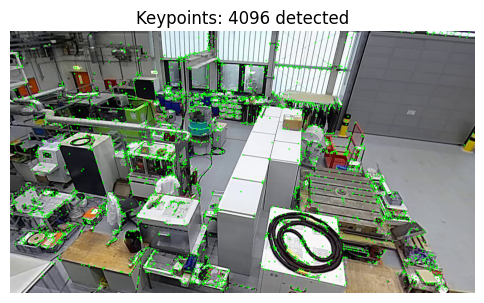

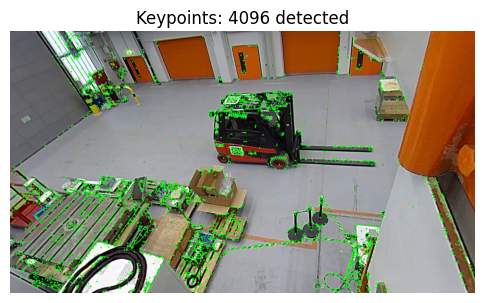

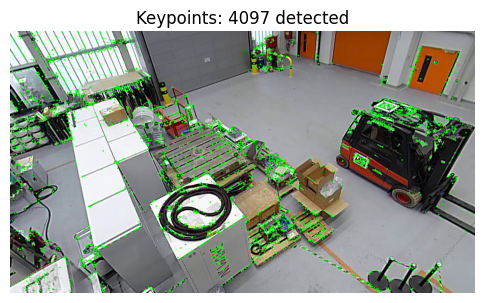

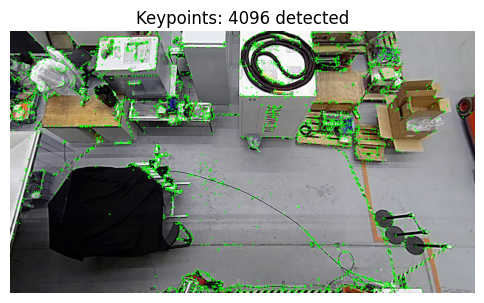

[PAIR] Crop 0 ↔ Crop 1: 558 matches


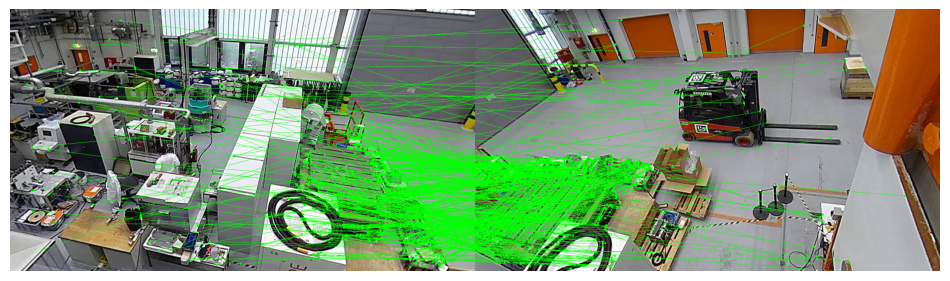

[PAIR] Crop 0 ↔ Crop 2: 1025 matches


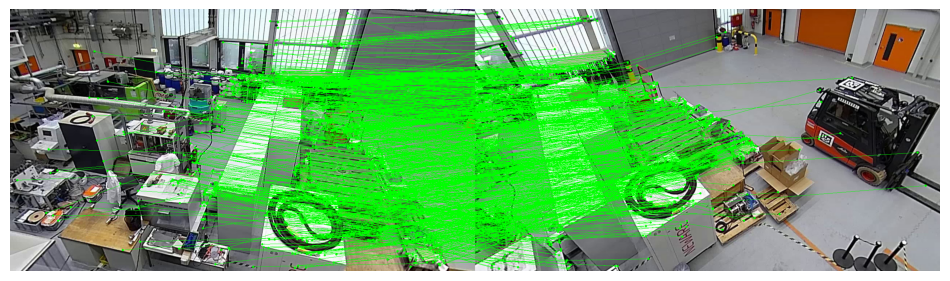

[PAIR] Crop 0 ↔ Crop 3: 697 matches


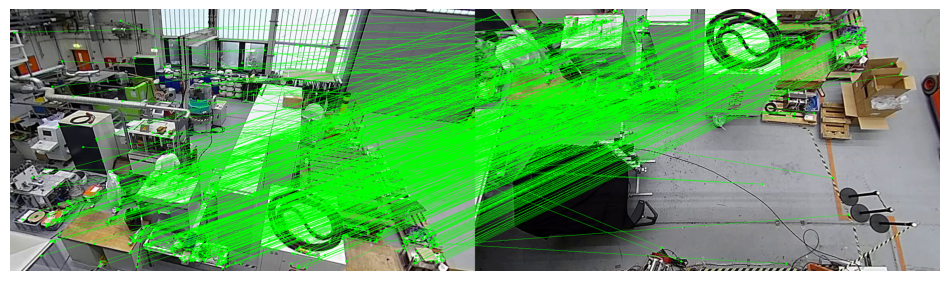

[PAIR] Crop 1 ↔ Crop 2: 1400 matches


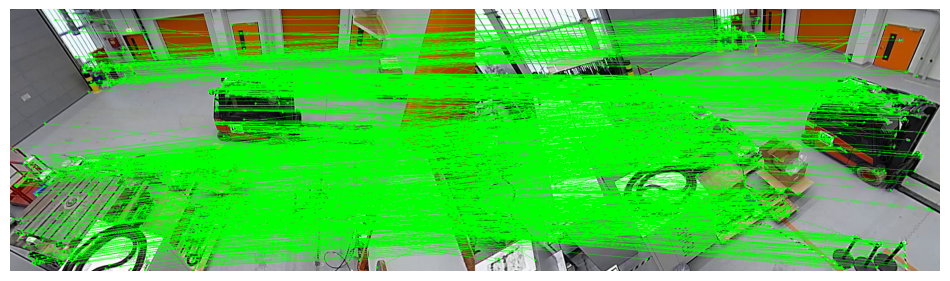

[PAIR] Crop 1 ↔ Crop 3: 960 matches


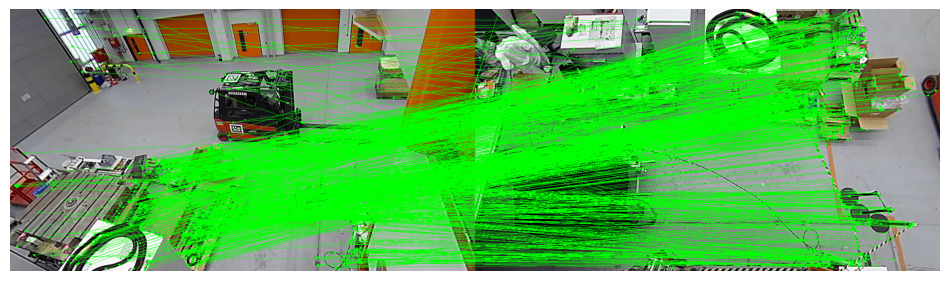

[PAIR] Crop 2 ↔ Crop 3: 868 matches


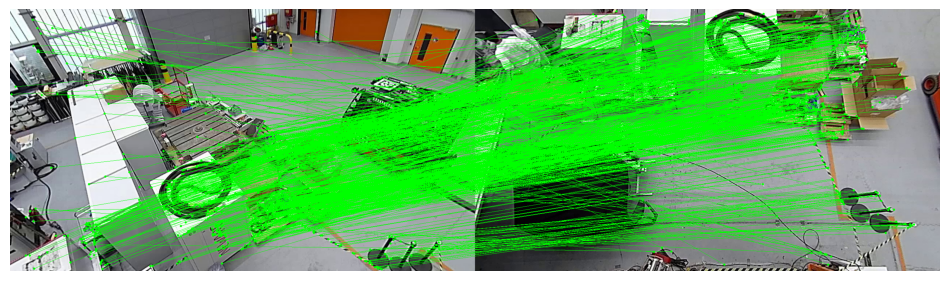

In [9]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"[INFO] Using device: {device}")

crop_paths = [
    "ohlf_fisheye/cam_233_view1.jpg",
    "ohlf_fisheye/cam_233_view2.jpg",
    "ohlf_fisheye/cam_233_view3.jpg",
    "ohlf_fisheye/cam_233_view4.jpg"
]

# ---------- Initialize SIFT ----------
sift = cv2.SIFT_create(
    nfeatures=4096,          
    contrastThreshold=0.02
    
)

keypoints_list, descriptors_list, images = [], [], []

for path in crop_paths:
    img = cv2.imread(path)
    if img is None:
        raise FileNotFoundError(f"Image not found: {path}")

    images.append(img)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    keypoints, descriptors = sift.detectAndCompute(gray, None)
    keypoints_list.append(keypoints)
    descriptors_list.append(descriptors)

    img_disp = img.copy()
    for kp in keypoints:
        x, y = kp.pt  
        cv2.circle(img_disp, (int(x), int(y)), 2, (0, 255, 0), -1)

    plt.figure(figsize=(6, 4))
    plt.imshow(cv2.cvtColor(img_disp, cv2.COLOR_BGR2RGB))
    plt.title(f"Keypoints: {len(keypoints)} detected")
    plt.axis('off')
    plt.show()

def match_features(desc1, desc2, ratio_thresh=0.8):
    desc1, desc2 = np.float32(desc1), np.float32(desc2)
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
    matches_knn = bf.knnMatch(desc1, desc2, k=2)
    matches = [m for m, n in matches_knn if m.distance < ratio_thresh * n.distance]
    return matches

n_crops = len(images)
matches_dict = {}

for i in range(n_crops):
    for j in range(i + 1, n_crops):
        matches = match_features(descriptors_list[i], descriptors_list[j])
        if len(matches) < 6:
            print(f"[PAIR] Crop {i} ↔ Crop {j}: not enough matches ({len(matches)})")
            continue
        mkpts0 = np.float32([keypoints_list[i][m.queryIdx].pt for m in matches])
        mkpts1 = np.float32([keypoints_list[j][m.trainIdx].pt for m in matches])
        matches_dict[(i, j)] = (mkpts0, mkpts1)
        print(f"[PAIR] Crop {i} ↔ Crop {j}: {len(mkpts0)} matches")
        img0 = images[i]
        img1 = images[j]
        h1, w1 = img0.shape[:2]
        h2, w2 = img1.shape[:2]
        canvas = np.zeros((max(h1, h2), w1 + w2, 3), dtype=np.uint8)
        canvas[:h1, :w1] = img0
        canvas[:h2, w1:] = img1

        for (x1, y1), (x2, y2) in zip(mkpts0.astype(int), mkpts1.astype(int)): 
            cv2.circle(canvas, (int(x1), int(y1)), 3, (0,255,0), -1)
            cv2.circle(canvas, (int(x2) + w1, int(y2)), 3, (0,255,0), -1)
            cv2.line(canvas, (int(x1), int(y1)), (int(x2) + w1, int(y2)), (0,255,0), 1)

        plt.figure(figsize=(12, 6))
        plt.imshow(cv2.cvtColor(canvas, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()



In [10]:


K_fisheye = np.array([
    [1274.7099536921774, 0.0, 640.0],
    [0.0, 1274.7099536921774, 360.0],
    [0.0, 0.0, 1.0],
], dtype=np.float64)


D_fisheye = np.zeros(4, dtype=np.float64)

K_rect = np.array([
    [1280.0, 0.0, 640.0],
    [0.0, 1280.0, 360.0],
    [0.0, 0.0, 1.0],
], dtype=np.float64)


def normalize(v):
  
    n = np.linalg.norm(v, axis=-1, keepdims=True)
    n[n == 0] = 1.0
    return v / n

def rectilinear_to_ray(px, K):
  
    px = np.asarray(px, np.float64).reshape(-1, 2)
    fx, fy = K[0,0], K[1,1]
    cx, cy = K[0,2], K[1,2]

    x = (px[:,0] - cx) / fx
    y = (px[:,1] - cy) / fy
    v = np.stack([x, y, np.ones_like(x)], axis=-1)  
    return normalize(v)

def fisheye_project_ray(ray, K, D=D_fisheye):
    
    pts = np.asarray(ray, np.float64).reshape(-1, 1, 3)
    imgpts, _ = cv2.fisheye.projectPoints(
        pts,
        np.zeros(3, dtype=np.float64),  
        np.zeros(3, dtype=np.float64),  
        K,
        D,
    )
    return imgpts.reshape(-1, 2)


def choose_ref(matches):
    counts = {}
    for (i, j), v in matches.items():
        counts[i] = counts.get(i, 0) + len(v[0])
        counts[j] = counts.get(j, 0) + len(v[1])

    return max(counts, key=counts.get) if counts else 0


def ransac_filter_rotation(mk0, mk1, K_rect, max_iter=500, sample_size=5, ang_thresh_deg=1.0):
   
    mk0 = np.asarray(mk0, dtype=np.float64)
    mk1 = np.asarray(mk1, dtype=np.float64)
    n = len(mk0)
    if n < 3:
        return np.zeros(n, dtype=bool)

    r0_all = rectilinear_to_ray(mk0, K_rect)
    r1_all = rectilinear_to_ray(mk1, K_rect)

    best_inliers = []
    ang_thresh = np.deg2rad(ang_thresh_deg)
    idxs = np.arange(n)

    for _ in range(max_iter):
        samp = np.random.choice(idxs, min(sample_size, n), replace=False)
        try:
            H = r0_all[samp].T @ r1_all[samp]
            U, _, Vt = np.linalg.svd(H)
            Rm = Vt.T @ U.T
            if np.linalg.det(Rm) < 0:
                Vt[-1, :] *= -1
                Rm = Vt.T @ U.T
        except Exception:
            continue

        r0_rot = (Rm @ r0_all.T).T
        cosang = np.clip(np.sum(r0_rot * r1_all, axis=1), -1.0, 1.0)
        ang = np.arccos(cosang)

        inliers = np.where(ang < ang_thresh)[0]
        if len(inliers) > len(best_inliers):
            best_inliers = inliers

        if len(best_inliers) > 0.95 * n:
            break

    mask = np.zeros(n, dtype=bool)
    if len(best_inliers) > 0:
        mask[best_inliers] = True

    return mask


# Build matches and choose reference 
REF_IDX = choose_ref(matches_dict)
print(f"[info] Reference crop index: {REF_IDX}")

pairs = []
for (i, j), v in matches_dict.items():
    mk0 = np.asarray(v[0], dtype=np.float64)
    mk1 = np.asarray(v[1], dtype=np.float64)
    if len(mk0) < 6:
        continue

    mask = ransac_filter_rotation(mk0, mk1, K_rect)
    mk0_in = mk0[mask]
    mk1_in = mk1[mask]
    if len(mk0_in) < 6:
        continue

    pairs.append((i, j, mk0_in, mk1_in))

print(f"[RANSAC] Retained {len(pairs)} pairs")


# Prepare BA variables 
n_crops = len(images)
camera_indices = [i for i in range(n_crops) if i != REF_IDX]


def pack_rotvecs(rot):
    return np.hstack([rot[i] for i in camera_indices]) if camera_indices else np.array([])


def unpack_rotvecs(x):
    r = {i: np.zeros(3, dtype=np.float64) for i in range(n_crops)}
    if x.size == 0:
        return r
    idx = 0
    for i in camera_indices:
        r[i] = x[idx:idx + 3].copy()
        idx += 3
    return r


rotvecs_init = {i: np.zeros(3, dtype=np.float64) for i in range(n_crops)}
x0 = pack_rotvecs(rotvecs_init)


# Ray-BA
def residuals_ray_BA(x):
    rotvecs = unpack_rotvecs(x)
    parts = []

    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        Ra = (R0 @ r0.T).T
        Rb = (R1 @ r1.T).T

        n = float(max(1.0, r0.shape[0]))
        parts.append((np.cross(Ra, Rb) / np.sqrt(n)).ravel())

    return np.hstack(parts) if parts else np.array([])


print("Running Ray-BA ...")
t0 = time.time()
res = least_squares(
    residuals_ray_BA,
    x0,
    loss="soft_l1",
    f_scale=0.8,
    ftol=1e-12,
    xtol=1e-12,
    max_nfev=400,
    verbose=2,
)
x_opt = res.x
rotvecs_opt = unpack_rotvecs(x_opt)
print(f"Ray-BA done, cost={res.cost:.6g}, time={(time.time() - t0):.1f}s")


# Pixel-BA 
def pixel_residuals(x):
    rotvecs = unpack_rotvecs(x)
    Kf = K_fisheye.copy()

    parts = []
    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        rw0 = (R0 @ r0.T).T
        rw1 = (R1 @ r1.T).T

        p0 = fisheye_project_ray(rw0, Kf)
        p1 = fisheye_project_ray(rw1, Kf)

        n = float(max(1.0, r0.shape[0]))
        parts.append(((p0 - p1) / np.sqrt(n)).ravel())

    return np.hstack(parts) if parts else np.array([])


print("pixel-space refinement...")
res_pix = least_squares(
    lambda x: pixel_residuals(x),
    x_opt,
    loss="soft_l1",
    f_scale=0.8,
    ftol=1e-12,
    xtol=1e-12,
    max_nfev=300,
    verbose=2,
)

x_pix = res_pix.x
rotvecs_opt = unpack_rotvecs(x_pix)


# Diagnostics
def compute_angular_error(rotvecs_dict):
    angs = []
    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs_dict[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs_dict[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        rw0 = (R0 @ r0.T).T
        rw1 = (R1 @ r1.T).T

        cosang = np.clip(np.sum(rw0 * rw1, axis=1), -1.0, 1.0)
        angs.extend(np.degrees(np.arccos(cosang)))

    return np.array(angs)


res_final = pixel_residuals(x_pix)
errs = np.linalg.norm(res_final.reshape(-1, 2), axis=1) if res_final.size else np.array([])
ang_errs_pix = compute_angular_error(rotvecs_opt)

sift_mean_px = np.nanmean(errs)
sift_median_px = np.nanmedian(errs)
sift_mean_ang = np.nanmean(ang_errs_pix)
sift_median_ang = np.nanmedian(ang_errs_pix)

for i in range(n_crops):
    if i == REF_IDX:
        R_opt = np.eye(3)
        print(f"\nCamera {i} (Reference):\n{R_opt}")
    else:
        R_opt = R.from_rotvec(rotvecs_opt[i]).as_matrix()
        print(f"\nCamera {i}:\n{R_opt}")
print(
    f"Pixel Error: mean={np.nanmean(errs):.3f}px, median={np.nanmedian(errs):.3f}px"
)
print(
    f"Angular Error: mean={np.nanmean(ang_errs_pix):.3f}°, median={np.nanmedian(ang_errs_pix):.3f}°"
)


[info] Reference crop index: 2
[RANSAC] Retained 6 pairs
Running Ray-BA ...
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         4.0132e-01                                    9.10e-01    
       1              2         1.6263e-02      3.85e-01       1.00e+00       1.80e-01    
       2              3         7.9813e-04      1.55e-02       2.44e-01       1.83e-02    
       3              4         6.5767e-04      1.40e-04       9.93e-03       2.53e-05    
       4              5         6.5767e-04      3.64e-10       7.53e-05       8.44e-08    
       5              6         6.5767e-04      7.67e-14       2.05e-06       2.29e-09    
`gtol` termination condition is satisfied.
Function evaluations 6, initial cost 4.0132e-01, final cost 6.5767e-04, first-order optimality 2.29e-09.
Ray-BA done, cost=0.000657665, time=0.2s
pixel-space refinement...
   Iteration     Total nfev        Cost      Cost reduction    Step norm

In [11]:
print(
f"SuperPoint + SuperGLue Pixel Error: mean={sp_sg_mean_px:.3f}px, median={sp_sg_median_px:.3f}px\n"
f"SuperPoint + SuperGLue Angular Error: mean={sp_sg_mean_ang:.3f}°, median={sp_sg_median_ang:.3f}°\n\n\n"
f"SuperPoint + LightGLue Pixel Error: mean={sp_lg_mean_px:.3f}px, median={sp_lg_median_px:.3f}px\n"
f"SuperPoint + LightGLue Angular Error: mean={sp_lg_mean_ang:.3f}°, median={sp_lg_median_ang:.3f}°\n\n\n"
f"ALIKED + LightGLue Pixel Error: mean={al_lg_mean_px:.3f}px, median={al_lg_median_px:.3f}px\n"
f"ALIKED + LightGLue Angular Error: mean={al_lg_mean_ang:.3f}°, median={al_lg_median_ang:.3f}°\n\n\n"
f"SIFT + BF Pixel Error: mean={sift_mean_px:.3f}px, median={sift_median_px:.3f}px\n"
f"SIFT + BF Angular Error: mean={sift_mean_ang:.3f}°, median={sift_median_ang:.3f}°"
)


SuperPoint + SuperGLue Pixel Error: mean=0.639px, median=0.549px
SuperPoint + SuperGLue Angular Error: mean=0.747°, median=0.680°


SuperPoint + LightGLue Pixel Error: mean=0.532px, median=0.470px
SuperPoint + LightGLue Angular Error: mean=0.658°, median=0.588°


ALIKED + LightGLue Pixel Error: mean=0.513px, median=0.460px
ALIKED + LightGLue Angular Error: mean=0.646°, median=0.622°


SIFT + BF Pixel Error: mean=0.627px, median=0.521px
SIFT + BF Angular Error: mean=0.711°, median=0.611°


In [ ]:


K_fisheye = np.array([
    [1274.7099536921774, 0.0, 640.0],
    [0.0, 1274.7099536921774, 360.0],
    [0.0, 0.0, 1.0],
], dtype=np.float64)


D_fisheye = np.zeros(4, dtype=np.float64)

K_rect = np.array([
    [1280.0, 0.0, 640.0],
    [0.0, 1280.0, 360.0],
    [0.0, 0.0, 1.0],
], dtype=np.float64)


def normalize(v):
  
    n = np.linalg.norm(v, axis=-1, keepdims=True)
    n[n == 0] = 1.0
    return v / n

def rectilinear_to_ray(px, K):
  
    px = np.asarray(px, np.float64).reshape(-1, 2)
    fx, fy = K[0,0], K[1,1]
    cx, cy = K[0,2], K[1,2]

    x = (px[:,0] - cx) / fx
    y = (px[:,1] - cy) / fy
    v = np.stack([x, y, np.ones_like(x)], axis=-1)  
    return normalize(v)

def fisheye_project_ray(ray, K, D=D_fisheye):
    
    pts = np.asarray(ray, np.float64).reshape(-1, 1, 3)
    imgpts, _ = cv2.fisheye.projectPoints(
        pts,
        np.zeros(3, dtype=np.float64),  
        np.zeros(3, dtype=np.float64),  
        K,
        D,
    )
    return imgpts.reshape(-1, 2)


def choose_ref(matches):
    counts = {}
    for (i, j), v in matches.items():
        counts[i] = counts.get(i, 0) + len(v[0])
        counts[j] = counts.get(j, 0) + len(v[1])

    return max(counts, key=counts.get) if counts else 0


def ransac_filter_rotation(mk0, mk1, K_rect, max_iter=200, sample_size=50, ang_thresh_deg=1):
   
    mk0 = np.asarray(mk0, dtype=np.float64)
    mk1 = np.asarray(mk1, dtype=np.float64)
    n = len(mk0)
    if n < 3:
        return np.zeros(n, dtype=bool)

    r0_all = rectilinear_to_ray(mk0, K_rect)
    r1_all = rectilinear_to_ray(mk1, K_rect)

    best_inliers = []
    ang_thresh = np.deg2rad(ang_thresh_deg)
    idxs = np.arange(n)

    for _ in range(max_iter):
        samp = np.random.choice(idxs, min(sample_size, n), replace=False)
        try:
            H = r0_all[samp].T @ r1_all[samp]
            U, _, Vt = np.linalg.svd(H)
            Rm = Vt.T @ U.T
            if np.linalg.det(Rm) < 0:
                Vt[-1, :] *= -1
                Rm = Vt.T @ U.T
        except Exception:
            continue

        r0_rot = (Rm @ r0_all.T).T
        cosang = np.clip(np.sum(r0_rot * r1_all, axis=1), -1.0, 1.0)
        ang = np.arccos(cosang)

        inliers = np.where(ang < ang_thresh)[0]
        if len(inliers) > len(best_inliers):
            best_inliers = inliers

        if len(best_inliers) > 0.95 * n:
            break

    mask = np.zeros(n, dtype=bool)
    if len(best_inliers) > 0:
        mask[best_inliers] = True

    return mask


# Build matches and choose reference 
REF_IDX = choose_ref(matches_dict)
print(f"[info] Reference crop index: {REF_IDX}")

pairs = []
for (i, j), v in matches_dict.items():
    mk0 = np.asarray(v[0], dtype=np.float64)
    mk1 = np.asarray(v[1], dtype=np.float64)
    if len(mk0) < 6:
        continue

    mask = ransac_filter_rotation(mk0, mk1, K_rect)
    mk0_in = mk0[mask]
    mk1_in = mk1[mask]
    if len(mk0_in) < 6:
        continue

    pairs.append((i, j, mk0_in, mk1_in))

print(f"[RANSAC] Retained {len(pairs)} pairs")


# Prepare BA variables 
n_crops = len(images)
camera_indices = [i for i in range(n_crops) if i != REF_IDX]

def pack_rotvecs(rot):
    return np.hstack([rot[i] for i in camera_indices]) if camera_indices else np.array([])


def unpack_rotvecs(x):
    r = {i: np.zeros(3, dtype=np.float64) for i in range(n_crops)}
    if x.size == 0:
        return r
    idx = 0
    for i in camera_indices:
        r[i] = x[idx:idx + 3].copy()
        idx += 3
    return r


rotvecs_init = {i: np.zeros(3, dtype=np.float64) for i in range(n_crops)}
x0 = pack_rotvecs(rotvecs_init)

def compute_angular_error(rotvecs_dict):
    angs = []
    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs_dict[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs_dict[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        rw0 = (R0 @ r0.T).T
        rw1 = (R1 @ r1.T).T

        cosang = np.clip(np.sum(rw0 * rw1, axis=1), -1.0, 1.0)
        angs.extend(np.degrees(np.arccos(cosang)))

    return np.array(angs)
# Ray-BA
def residuals_ray_BA(x):
    rotvecs = unpack_rotvecs(x)
    parts = []

    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        Ra = (R0 @ r0.T).T
        Rb = (R1 @ r1.T).T

        n = float(max(1.0, r0.shape[0]))
        parts.append((np.cross(Ra, Rb) / np.sqrt(n)).ravel())

    return np.hstack(parts) if parts else np.array([])


print("Running Ray-BA ...")
t0 = time.time()
res = least_squares(residuals_ray_BA,x0,loss="soft_l1",f_scale=1,ftol=1e-12,xtol=1e-12,max_nfev=400,verbose=2)
x_opt = res.x
rotvecs_opt = unpack_rotvecs(x_opt)
# print(f"Ray-BA done, cost={res.cost:.6g}, time={(time.time() - t0):.1f}s")
# for iteration in range(3):
#     kept = []
#     for (i,j,mk0,mk1) in pairs:
#         R0 = np.eye(3) if i==REF_IDX else R.from_rotvec(rotvecs_opt[i]).as_matrix()
#         R1 = np.eye(3) if j==REF_IDX else R.from_rotvec(rotvecs_opt[j]).as_matrix()
#         r0 = rectilinear_to_ray(mk0, K_rect)
#         r1 = rectilinear_to_ray(mk1, K_rect)
#         cosang = np.clip(np.sum((R0@r0.T).T * (R1@r1.T).T, axis=1), -1, 1)
#         ang = np.degrees(np.arccos(cosang))
#         thr = np.percentile(ang, 80)
#         mask = ang <= thr
#         if np.count_nonzero(mask) > 5:
#             kept.append((i, j, mk0[mask], mk1[mask]))
#     if not kept:
#         print(f"[clean-refit] iteration {iteration}: nothing kept, stopping.")
#         break
#     pairs = kept
#     res = least_squares(residuals_ray_BA,x_opt,loss="soft_l1",f_scale=1,ftol=1e-12,xtol=1e-12,max_nfev=400,verbose=2)
#     x_opt_fit = res.x
#     rotvecs_opt = unpack_rotvecs(x_opt)
#     print(f"[clean-refit] iter={iteration}, cost={res.cost:.6g}, pairs={len(pairs)}")

# rotvecs_ray_opt = rotvecs_opt.copy()


# Pixel-BA 
def pixel_residuals(x):
    rotvecs = unpack_rotvecs(x)
    Kf = K_fisheye.copy()

    parts = []
    for (i, j, mk0, mk1) in pairs:
        R0 = np.eye(3) if i == REF_IDX else R.from_rotvec(rotvecs[i]).as_matrix()
        R1 = np.eye(3) if j == REF_IDX else R.from_rotvec(rotvecs[j]).as_matrix()

        r0 = rectilinear_to_ray(mk0, K_rect)
        r1 = rectilinear_to_ray(mk1, K_rect)

        rw0 = (R0 @ r0.T).T
        rw1 = (R1 @ r1.T).T

        p0 = fisheye_project_ray(rw0, Kf)
        p1 = fisheye_project_ray(rw1, Kf)

        n = float(max(1.0, r0.shape[0]))
        parts.append(((p0 - p1) / np.sqrt(n)).ravel())

    return np.hstack(parts) if parts else np.array([])


print("pixel-space refinement...")
res_pix = least_squares(lambda x: pixel_residuals(x), x_opt, loss="soft_l1", f_scale=1, ftol=1e-12, xtol=1e-12, max_nfev=300, verbose=2)

x_pix = res_pix.x
rotvecs_opt = unpack_rotvecs(x_pix)

# Diagnostics
res_final = pixel_residuals(x_pix)
errs = np.linalg.norm(res_final.reshape(-1, 2), axis=1) if res_final.size else np.array([])
ang_errs_pix = compute_angular_error(rotvecs_opt)

al_lg_mean_px = np.nanmean(errs)
al_lg_median_px = np.nanmedian(errs)
al_lg_mean_ang = np.nanmean(ang_errs_pix)
al_lg_median_ang = np.nanmedian(ang_errs_pix)
R_list = []
for i in range(n_crops):
    if i == REF_IDX:
        R_opt = np.eye(3)
        print(f"\nCamera {i} (Reference):\n{R_opt}")
    else:
        R_opt = R.from_rotvec(rotvecs_opt[i]).as_matrix()
        print(f"\nCamera {i}:\n{R_opt}")
    R_list.append(R_opt)
print(
    f"Pixel Error: mean={np.nanmean(errs):.3f}px, median={np.nanmedian(errs):.3f}px"
)
print(
    f"Angular Error: mean={np.nanmean(ang_errs_pix):.3f}°, median={np.nanmedian(ang_errs_pix):.3f}°"
)
